# Area Calculation and Conversion from Pixel to cm²

This notebook demonstrates how to calculate the area of detected regions in images using different methods. We will use both adaptive thresholding and the Segment Anything Model (SAM) for segmentation, and convert the area from pixels to real-world units (cm²).


## Setup and Import Libraries

We begin by importing the necessary libraries for image processing, segmentation, and area calculation.


## Functions for Image Processing

Then we define several functions to preprocess images, remove hair artifacts, calculate adaptive thresholds, and apply masks.


## Process Images Using Adaptive Thresholding

We will process each image in the specified directory, apply adaptive thresholding to detect regions, and calculate the area of these regions.

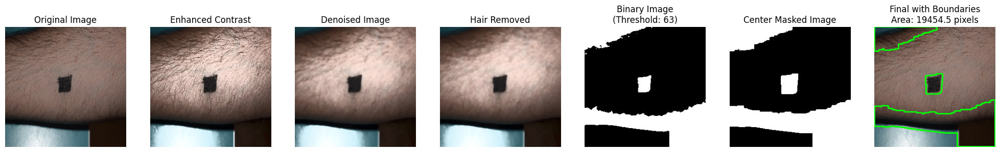

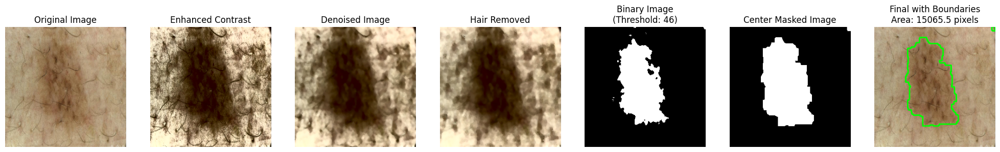

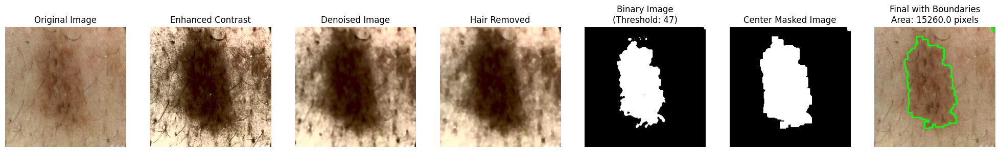

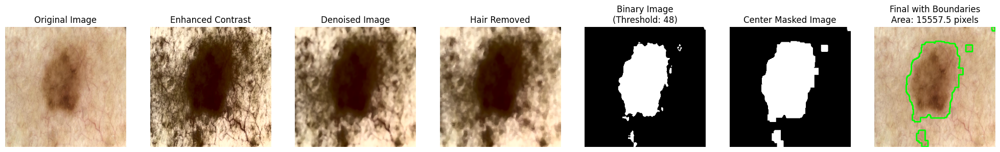

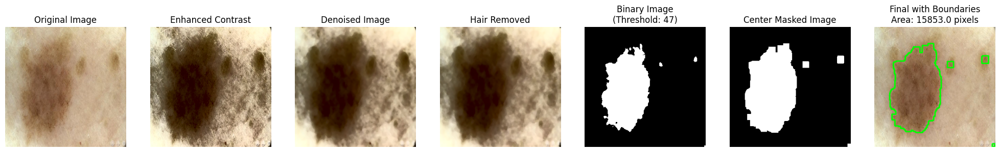

...

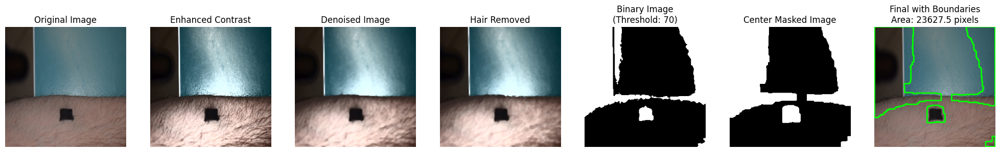

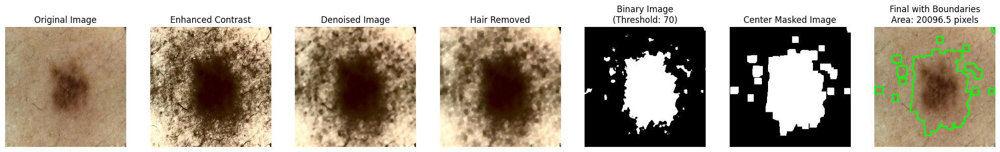

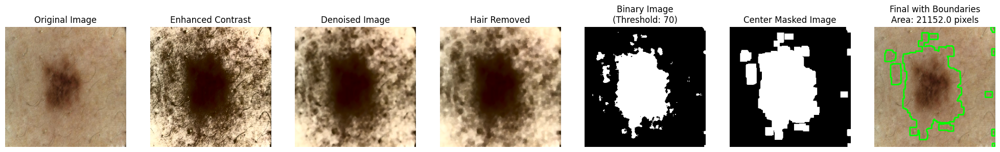

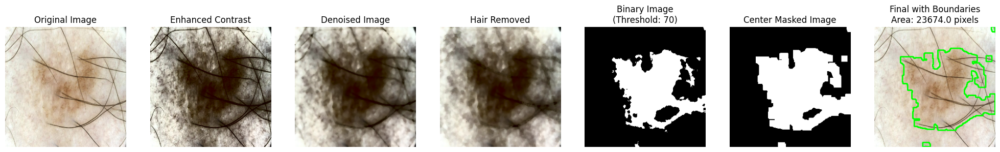

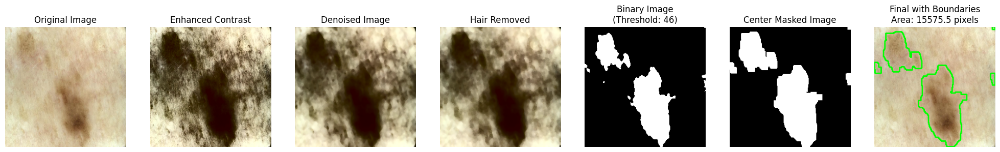

DSC_9385.jpg: 19454.5 pixels
ISIC_8366295.JPG: 15065.5 pixels
ISIC_6623311.JPG: 15260.0 pixels
ISIC_1255817.JPG: 15557.5 pixels
ISIC_7385926.JPG: 15853.0 pixels
ISIC_7394499.JPG: 24262.5 pixels
ISIC_1596131.JPG: 15835.0 pixels
DSC_9381.jpg: 20441.0 pixels
ISIC_8480991.JPG: 15031.0 pixels
ISIC_1144433.JPG: 20802.0 pixels
ISIC_7966639.JPG: 18546.5 pixels
ISIC_8990535.JPG: 16151.5 pixels
ISIC_7156572.JPG: 15816.5 pixels
ISIC_9687656.JPG: 15605.5 pixels
DSC_9382.jpg: 20463.5 pixels
ISIC_1120622.JPG: 15350.5 pixels
DSC_9384.jpg: 20978.5 pixels
DSC_9386.jpg: 18160.5 pixels
DSC_9390.jpg: 14449.5 pixels
ISIC_7262436.JPG: 24633.0 pixels
ISIC_7088218.JPG: 21728.5 pixels
ISIC_8532076.JPG: 21389.5 pixels
ISIC_7756030.JPG: 24475.5 pixels
ISIC_6068905.JPG: 21572.5 pixels
DSC_9383.jpg: 21358.0 pixels
DSC_9391.jpg: 20991.5 pixels
ISIC_1470864.JPG: 15439.5 pixels
DSC_9392.jpg: 13106.5 pixels
ISIC_6489162.JPG: 15185.0 pixels
ISIC_5697873.JPG: 15594.0 pixels
DSC_9389.jpg: 20491.5 pixels
DSC_9388.jpg: 214

In [22]:
import os
import cv2
import numpy as np
import matplotlib.pyplot as plt

# Ensure results directory exists
results_dir = '/content/area'
os.makedirs(results_dir, exist_ok=True)

# Define the kernel for morphological operations
kernel = np.ones((5, 5), np.uint8)

# Function to remove hair artifacts
def remove_hair(image):
    gray_image = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)
    blackhat = cv2.morphologyEx(gray_image, cv2.MORPH_BLACKHAT, kernel)
    _, thresh = cv2.threshold(blackhat, 10, 255, cv2.THRESH_BINARY)
    hair_removed = cv2.inpaint(image, thresh, 1, cv2.INPAINT_TELEA)
    return hair_removed

def calculate_adaptive_threshold(gray_image, min_threshold=40, max_threshold=70, adjustment_factor=35):
    """
    Calculate adaptive threshold based on the darkest part of the image with min and max limits.

    Parameters:
    - gray_image: Grayscale image for which to calculate the threshold.
    - min_threshold: Minimum threshold value.
    - max_threshold: Maximum threshold value.
    - adjustment_factor: Factor to adjust the threshold based on the darkest part.

    Returns:
    - threshold_value: Calculated threshold value.
    """
    # Calculate histogram
    hist = cv2.calcHist([gray_image], [0], None, [256], [0, 256])
    # Find the darkest part
    darkest = np.where(hist == np.max(hist[:128]))[0][0]
    # Set the threshold closer to the darkest part with limits
    threshold_value = darkest + adjustment_factor
    threshold_value = max(min_threshold, min(threshold_value, max_threshold))
    return threshold_value

# Function to mask only the central region of the image
def apply_center_mask(image, size=128):
    """
    Apply a mask to keep only the central region of the image.

    Parameters:
    - image: Input binary image.
    - size: Size of the central square region to keep.

    Returns:
    - masked_image: Image with only the central region kept.
    """
    h, w = image.shape[:2]
    center_x, center_y = w // 2, h // 2
    x1, y1 = center_x - size // 2, center_y - size // 2
    x2, y2 = center_x + size // 2, center_y + size // 2

    mask = np.zeros_like(image)
    mask[y1:y2, x1:x2] = 255
    masked_image = cv2.bitwise_and(image, mask)
    return masked_image

# Process each image in the /content/images/ directory
images_dir = '/content/images'
areas = {}  # Dictionary to store areas of lesions
for filename in os.listdir(images_dir):
    if filename.lower().endswith(('.png', '.jpg', '.jpeg', '.bmp', '.tiff')):
        # Load the image
        image_path = os.path.join(images_dir, filename)
        image = cv2.imread(image_path)

        # Resize the image to 256x256 pixels
        image = cv2.resize(image, (256, 256))

        # Step 1: Enhance contrast
        lab = cv2.cvtColor(image, cv2.COLOR_BGR2LAB)
        l, a, b = cv2.split(lab)
        l = cv2.equalizeHist(l)
        enhanced_image = cv2.merge((l, a, b))
        enhanced_image = cv2.cvtColor(enhanced_image, cv2.COLOR_LAB2BGR)

        # Step 2: Remove noise
        denoised_image = cv2.medianBlur(enhanced_image, 5)

        # Step 3: Remove hair artifacts
        hair_removed_image = remove_hair(denoised_image)

        # Convert to grayscale
        gray_image = cv2.cvtColor(hair_removed_image, cv2.COLOR_BGR2GRAY)

        # Calculate adaptive threshold
        adaptive_threshold = calculate_adaptive_threshold(gray_image)

        # Apply a binary threshold based on the adaptive threshold
        _, binary_image = cv2.threshold(gray_image, adaptive_threshold, 255, cv2.THRESH_BINARY_INV)

        # Apply morphological operations to focus on areas rather than single pixels
        closed_image = cv2.morphologyEx(binary_image, cv2.MORPH_CLOSE, kernel)
        opened_image = cv2.morphologyEx(closed_image, cv2.MORPH_OPEN, kernel)

        # Dilate the image to enlarge the area of the regions
        dilated_image = cv2.dilate(opened_image, kernel, iterations=2)

        # Apply the center mask
        center_masked_image = apply_center_mask(dilated_image)
        center_masked_image = dilated_image.copy()

        # Find contours of the center-masked image
        contours, _ = cv2.findContours(center_masked_image, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)

        # Draw contours on the original image
        image_with_contours = image.copy()
        cv2.drawContours(image_with_contours, contours, -1, (0, 255, 0), 2)  # Green contours with thickness of 2

        # Calculate the area of each contour
        lesion_areas = [cv2.contourArea(contour) for contour in contours]
        total_lesion_area = sum(lesion_areas)
        areas[filename] = total_lesion_area

        # Display the results and save them to the results directory
        plt.figure(figsize=(25, 10))
        plt.subplot(1, 7, 1)
        plt.imshow(cv2.cvtColor(image, cv2.COLOR_BGR2RGB))
        plt.title('Original Image')
        plt.axis('off')

        plt.subplot(1, 7, 2)
        plt.imshow(cv2.cvtColor(enhanced_image, cv2.COLOR_BGR2RGB))
        plt.title('Enhanced Contrast')
        plt.axis('off')

        plt.subplot(1, 7, 3)
        plt.imshow(cv2.cvtColor(denoised_image, cv2.COLOR_BGR2RGB))
        plt.title('Denoised Image')
        plt.axis('off')

        plt.subplot(1, 7, 4)
        plt.imshow(cv2.cvtColor(hair_removed_image, cv2.COLOR_BGR2RGB))
        plt.title('Hair Removed')
        plt.axis('off')

        plt.subplot(1, 7, 5)
        plt.imshow(binary_image, cmap='gray')
        plt.title(f'Binary Image\n(Threshold: {adaptive_threshold})')
        plt.axis('off')

        plt.subplot(1, 7, 6)
        plt.imshow(center_masked_image, cmap='gray')
        plt.title('Center Masked Image')
        plt.axis('off')

        plt.subplot(1, 7, 7)
        plt.imshow(cv2.cvtColor(image_with_contours, cv2.COLOR_BGR2RGB))
        plt.title(f'Final with Boundaries\nArea: {total_lesion_area} pixels')
        plt.axis('off')

        # Save the figure
        result_path = os.path.join(results_dir, f"{os.path.splitext(filename)[0]}_result.png")
        plt.savefig(result_path)

        # Show the figure
        plt.show()
        plt.close()

# Print the areas of lesions
for filename, area in areas.items():
    print(f"{filename}: {area} pixels")

print("Processing and saving of images completed.")


## Convert Pixel Area to Real-World Area (cm²)

Using image metadata, we calculate the real-world area in cm² for a given image and its pixel area.


In [23]:
import os
import cv2
import numpy as np
import matplotlib.pyplot as plt
import exifread

# Function to get image metadata
def get_image_metadata(image_path):
    with open(image_path, 'rb') as f:
        tags = exifread.process_file(f)
    return tags

# Function to calculate the real-world area in cm²
def calculate_real_world_area(image_path, pixel_area, resized_dim=(256, 256), dpi=300):
    metadata = get_image_metadata(image_path)

    # Extract sensor width and height (assuming standard 35mm format if not available)
    sensor_width_tag = 'EXIF FocalPlaneXResolution'
    sensor_height_tag = 'EXIF FocalPlaneYResolution'
    sensor_unit_tag = 'EXIF FocalPlaneResolutionUnit'

    sensor_width_mm = 36  # Default value for a full-frame sensor
    sensor_height_mm = 24  # Default value for a full-frame sensor
    if sensor_width_tag in metadata and sensor_height_tag in metadata and sensor_unit_tag in metadata:
        resolution_unit = metadata[sensor_unit_tag].values[0]
        if resolution_unit == 3:  # Resolution unit is in cm
            sensor_width_mm = 10 / (float(metadata[sensor_width_tag].values[0].num) / float(metadata[sensor_width_tag].values[0].den))
            sensor_height_mm = 10 / (float(metadata[sensor_height_tag].values[0].num) / float(metadata[sensor_height_tag].values[0].den))
        elif resolution_unit == 2:  # Resolution unit is in inches
            sensor_width_mm = 25.4 / (float(metadata[sensor_width_tag].values[0].num) / float(metadata[sensor_width_tag].values[0].den))
            sensor_height_mm = 25.4 / (float(metadata[sensor_height_tag].values[0].num) / float(metadata[sensor_height_tag].values[0].den))

    print(f"Sensor Width: {sensor_width_mm} mm")
    print(f"Sensor Height: {sensor_height_mm} mm")

    # Get original image dimensions
    image = cv2.imread(image_path)
    original_height, original_width = image.shape[:2]
    print(f"Original Image Dimensions: {original_width}x{original_height} pixels")

    # Get resized image dimensions
    resized_width, resized_height = resized_dim
    print(f"Resized Image Dimensions: {resized_width}x{resized_height} pixels")

    # Calculate scaling factor
    scaling_factor_width = original_width / resized_width
    scaling_factor_height = original_height / resized_height
    scaling_factor = (scaling_factor_width + scaling_factor_height) / 2
    print(f"Scaling Factor: {scaling_factor}")

    # Adjust sensor dimensions by scaling factor
    adjusted_sensor_width_mm = sensor_width_mm * scaling_factor
    adjusted_sensor_height_mm = sensor_height_mm * scaling_factor
    print(f"Adjusted Sensor Width: {adjusted_sensor_width_mm} mm")
    print(f"Adjusted Sensor Height: {adjusted_sensor_height_mm} mm")

    # Calculate sensor area in mm²
    adjusted_sensor_area_mm2 = adjusted_sensor_width_mm * adjusted_sensor_height_mm
    print(f"Adjusted Sensor Area: {adjusted_sensor_area_mm2} mm²")

    # Calculate the pixel density (pixels per mm²)
    pixel_density = (original_width * original_height) / adjusted_sensor_area_mm2
    print(f"Pixel Density: {pixel_density} pixels/mm²")

    # Calculate the real-world area in mm²
    real_world_area_mm2 = pixel_area / pixel_density
    print(f"Real-World Area: {real_world_area_mm2} mm²")

    # Convert mm² to cm²
    real_world_area_cm2 = real_world_area_mm2 / 100 * 2.54

    return real_world_area_cm2

# Example usage with DSC_9383.jpg
image_path = '/content/images/ISIC_8366295.JPG'
pixel_area = areas['ISIC_8366295.JPG']  # Area in pixels from the earlier script

real_world_area = calculate_real_world_area(image_path, pixel_area)
print(f"Real-world area for DSC_9383.jpg: {real_world_area:.3f} cm²")


Sensor Width: 36 mm
Sensor Height: 24 mm
Original Image Dimensions: 742x477 pixels
Resized Image Dimensions: 256x256 pixels
Scaling Factor: 2.380859375
Adjusted Sensor Width: 85.7109375 mm
Adjusted Sensor Height: 57.140625 mm
Adjusted Sensor Area: 4897.5765380859375 mm²
Pixel Density: 72.26717076244486 pixels/mm²
Real-World Area: 208.469486781529 mm²
Real-world area for DSC_9383.jpg: 5.295 cm²


pixel-wise area of a single lesion image (change it according to your image name)

In [ ]:
areas['DSC_9383.jpg']

1747.0

## Calculate 3D Model Surface Area from OBJ Files (TESTS)

For 3D models, we can calculate the surface area of specific regions, such as black-colored areas, from .obj files using the Trimesh library.

In [ ]:
import trimesh
import numpy as np

# Load the 3D model from the .obj file
scene_or_mesh = trimesh.load('/content/texturedMesh.obj')

# Ensure the mesh is properly extracted from the scene if necessary
if isinstance(scene_or_mesh, trimesh.Scene):
    # Combine all geometries into a single Trimesh object
    mesh = trimesh.util.concatenate(scene_or_mesh.dump())
elif isinstance(scene_or_mesh, trimesh.Trimesh):
    mesh = scene_or_mesh
else:
    raise TypeError("The loaded object is neither a Scene nor a Trimesh object")

# Function to check if a color is black
def is_black_color(color, threshold=50):
    # Check if the color is black within a threshold
    return np.all(color[:3] < threshold)  # Consider RGB values only

# Get the colors of each vertex
if not hasattr(mesh.visual, 'vertex_colors'):
    raise ValueError("The mesh does not contain vertex color information")

vertex_colors = mesh.visual.vertex_colors

# Initialize a list to hold the area of black triangles
black_triangle_areas = []

# Iterate over each face (triangle) and check its color
for i, face in enumerate(mesh.faces):
    # Get the colors of the vertices of the face
    triangle_colors = vertex_colors[face]
    if all(is_black_color(color) for color in triangle_colors):
        # If all vertices of the triangle are black, calculate its area and add to the list
        triangle_area = mesh.area_faces[i]
        black_triangle_areas.append(triangle_area)

# Sum the areas of the black triangles
total_black_area_mm2 = np.sum(black_triangle_areas)
print(f"Total black surface area in mm²: {total_black_area_mm2:.3f}")

# Convert the area from mm² to cm²
total_black_area_cm2 = total_black_area_mm2 / 100
print(f"Total black surface area in cm²: {total_black_area_cm2:.3f}")


In [ ]:
import numpy as np
import trimesh
import imageio

def load_exr_image(file_path):
    img = imageio.imread(file_path, format='EXR')
    return img

def is_black(pixel, threshold=0.01):
    return np.all(pixel < threshold)

def load_obj_mtl(obj_path, mtl_path):
    mesh = trimesh.load_mesh(obj_path)
    materials = trimesh.visual.material.load_mtl(mtl_path)
    return mesh, materials

def calculate_black_area(mesh, texture):
    black_vertices = []

    for vertex in mesh.visual.uv:
        u, v = vertex
        u = int(u * (texture.shape[1] - 1))
        v = int((1 - v) * (texture.shape[0] - 1))
        if is_black(texture[v, u]):
            black_vertices.append(vertex)

    black_vertex_indices = set()
    for i, vertex in enumerate(mesh.visual.uv):
        if any(np.all(vertex == bv) for bv in black_vertices):
            black_vertex_indices.add(i)

    black_faces = []
    for face in mesh.faces:
        if any(v in black_vertex_indices for v in face):
            black_faces.append(face)

    black_area = 0.0
    for face in black_faces:
        vertices = mesh.vertices[face]
        face_area = trimesh.triangles.area(vertices)
        black_area += face_area

    return black_area

# Convert area from m² to cm²
def convert_to_cm2(area_in_m2):
    return area_in_m2 * 10000  # 1 m² = 10,000 cm²



# Load the textures
texture1 = load_exr_image(texture_path1)
texture2 = load_exr_image(texture_path2)

# Combine textures if necessary (or use one of them)
combined_texture = np.maximum(texture1, texture2)

# Load the obj and mtl files
mesh, materials = load_obj_mtl(obj_path, mtl_path)

# Calculate the area of black vertices
black_area_m2 = calculate_black_area(mesh, combined_texture)
black_area_cm2 = convert_to_cm2(black_area_m2)

print(f'Total area of black vertices: {black_area_cm2} cm²')


In [ ]:
import numpy as np
import trimesh
import OpenEXR
import Imath

def load_exr_image(file_path):
    exr_file = OpenEXR.InputFile(file_path)
    header = exr_file.header()
    dw = header['dataWindow']
    width = dw.max.x - dw.min.x + 1
    height = dw.max.y - dw.min.y + 1
    pt = Imath.PixelType(Imath.PixelType.FLOAT)

    redstr = exr_file.channel('R', pt)
    greenstr = exr_file.channel('G', pt)
    bluestr = exr_file.channel('B', pt)

    red = np.frombuffer(redstr, dtype=np.float32).reshape(height, width)
    green = np.frombuffer(greenstr, dtype=np.float32).reshape(height, width)
    blue = np.frombuffer(bluestr, dtype=np.float32).reshape(height, width)

    return np.stack([red, green, blue], axis=-1)

def is_black(pixel, threshold=0.01):
    return np.all(pixel < threshold)

def load_obj(obj_path):
    scene = trimesh.load(obj_path)
    if isinstance(scene, trimesh.Scene):
        combined = trimesh.util.concatenate(scene.dump())
        return combined
    elif isinstance(scene, trimesh.Trimesh):
        return scene
    else:
        raise ValueError("Unsupported mesh format.")

def calculate_black_area(mesh, texture):
    black_vertices = []

    for vertex in mesh.visual.uv:
        u, v = vertex
        u = min(max(int(u * (texture.shape[1] - 1)), 0), texture.shape[1] - 1)
        v = min(max(int((1 - v) * (texture.shape[0] - 1)), 0), texture.shape[0] - 1)
        if is_black(texture[v, u]):
            black_vertices.append(vertex)

    black_vertex_indices = set()
    for i, vertex in enumerate(mesh.visual.uv):
        if any(np.all(vertex == bv) for bv in black_vertices):
            black_vertex_indices.add(i)

    black_faces = []
    for face in mesh.faces:
        if any(v in black_vertex_indices for v in face):
            black_faces.append(face)

    black_area = 0.0
    for face in black_faces:
        vertices = mesh.vertices[face]
        face_area = trimesh.triangles.area(vertices)
        black_area += face_area

    return black_area

# Convert area from m² to cm²
def convert_to_cm2(area_in_m2):
    return area_in_m2 * 10000  # 1 m² = 10,000 cm²

# Paths to your files
obj_path = '/content/texturedMesh.obj'
mtl_path = '/content/texturedMesh.mtl'
texture_path1 = '/content/texture_1001.exr'
texture_path2 = '/content/texture_1002.exr'

# Load the textures
texture1 = load_exr_image(texture_path1)
texture2 = load_exr_image(texture_path2)

# Combine textures if necessary (or use one of them)
combined_texture = np.maximum(texture1, texture2)

# Load the obj file (the mtl file should be referenced within the obj file)
mesh = load_obj(obj_path)

# Calculate the area of black vertices
black_area_m2 = calculate_black_area(mesh, combined_texture)
black_area_cm2 = convert_to_cm2(black_area_m2)

print(f'Total area of black vertices: {black_area_cm2} cm²')


## Process Images Using SAM and Combine with Adaptive Thresholding

We combine the SAM and adaptive thresholding methods to improve segmentation results. The area of the segmented regions is calculated and saved.


In [ ]:
def evaluate_mask(mask, image_shape):
    """
    Evaluate the mask based on its size and compactness.
    """
    area = np.sum(mask)
    labeled_mask, num_features = measure.label(mask, return_num=True, connectivity=2)
    regions = measure.regionprops(labeled_mask)
    if len(regions) == 0:
        return 0

    region = max(regions, key=lambda r: r.area)
    perimeter = region.perimeter
    compactness = (perimeter ** 2) / area

    image_area = image_shape[0] * image_shape[1]
    size_ratio = area / image_area
    size_score = 1 if 0.01 < size_ratio < 0.5 else 0
    compactness_score = 1 / (1 + compactness)

    return size_score * compactness_score

# Load the SAM model
sam_checkpoint = "sam_vit_h_4b8939.pth"
model_type = "vit_h"
device = "cuda" if torch.cuda.is_available() else "cpu"

sam = sam_model_registry[model_type](checkpoint=sam_checkpoint)
sam.to(device=device)

# Create SAM automatic mask generator
mask_generator = SamAutomaticMaskGenerator(sam)

# Process each image in the directory
images_dir = '/content/segment'
combined_areas = {}

for filename in os.listdir(images_dir):
    if filename.lower().endswith(('.png', '.jpg', '.jpeg', '.bmp', '.tiff')):
        image_path = os.path.join(images_dir, filename)
        image = cv2.imread(image_path)
        image = cv2.resize(image, (256, 256))

        # Step 1: Enhance contrast
        lab = cv2.cvtColor(image, cv2.COLOR_BGR2LAB)
        l, a, b = cv2.split(lab)
        l = cv2.equalizeHist(l)
        enhanced_image = cv2.merge((l, a, b))
        enhanced_image = cv2.cvtColor(enhanced_image, cv2.COLOR_LAB2BGR)

        # Step 2: Remove noise
        denoised_image = cv2.medianBlur(enhanced_image, 5)

        # Step 3: Remove hair artifacts
        hair_removed_image = remove_hair(denoised_image)

        # Convert to grayscale
        gray_image = cv2.cvtColor(hair_removed_image, cv2.COLOR_BGR2GRAY)

        # Calculate adaptive threshold
        adaptive_threshold = calculate_adaptive_threshold(gray_image)

        # Apply a binary threshold
        _, binary_image = cv2.threshold(gray_image, adaptive_threshold, 255, cv2.THRESH_BINARY_INV)

        # Apply morphological operations
        closed_image = cv2.morphologyEx(binary_image, cv2.MORPH_CLOSE, kernel)
        opened_image = cv2.morphologyEx(closed_image, cv2.MORPH_OPEN, kernel)

        # Dilate the image
        dilated_image = cv2.dilate(opened_image, kernel, iterations=2)

        # Use the SAM model to generate masks
        resized_image = cv2.cvtColor(dilated_image, cv2.COLOR_GRAY2RGB)
        masks = mask_generator.generate(resized_image)

        if not masks:
            print(f"No masks generated for image: {filename}")
            continue

        # Combine the adaptive threshold mask and the SAM mask
        best_sam_mask = max(masks, key=lambda x: evaluate_mask(x['segmentation'], image.shape))
        sam_mask = best_sam_mask['segmentation']
        sam_mask_binary = sam_mask.astype(np.uint8) * 255

        combined_mask = np.zeros_like(dilated_image)
        combined_mask[dilated_image == 255] = 255
        combined_mask[sam_mask_binary == 255] = 255

        # Calculate the area of the final mask
        combined_area = np.sum(combined_mask) // 255
        combined_areas[filename] = combined_area

        # Display the results
        plt.figure(figsize=(25, 10))
        plt.subplot(1, 8, 1)
        plt.imshow(cv2.cvtColor(image, cv2.COLOR_BGR2RGB))
        plt.title('Original Image')
        plt.axis('off')

        plt.subplot(1, 8, 2)
        plt.imshow(cv2.cvtColor(enhanced_image, cv2.COLOR_BGR2RGB))
        plt.title('Enhanced Contrast')
        plt.axis('off')

        plt.subplot(1, 8, 3)
        plt.imshow(cv2.cvtColor(denoised_image, cv2.COLOR_BGR2RGB))
        plt.title('Denoised Image')
        plt.axis('off')

        plt.subplot(1, 8, 4)
        plt.imshow(cv2.cvtColor(hair_removed_image, cv2.COLOR_BGR2RGB))
        plt.title('Hair Removed')
        plt.axis('off')

        plt.subplot(1, 8, 5)
        plt.imshow(binary_image, cmap='gray')
        plt.title(f'Binary Image\n(Threshold: {adaptive_threshold})')
        plt.axis('off')

        plt.subplot(1, 8, 6)
        plt.imshow(resized_image)
        show_mask(best_sam_mask['segmentation'], plt.gca(), random_color=True)
        plt.title('SAM Mask')
        plt.axis('off')

        plt.subplot(1, 8, 7)
        plt.imshow(binary_image, cmap='gray')
        plt.title('Adaptive Threshold Mask')
        plt.axis('off')

        plt.subplot(1, 8, 8)
        plt.imshow(combined_mask, cmap='gray')
        plt.title(f'Combined Mask\nArea: {combined_area} pixels')
        plt.axis('off')

        # Save the figure
        result_path = os.path.join(results_dir, f"{os.path.splitext(filename)[0]}_result.png")
        plt.savefig(result_path)

        # Show the figure
        plt.show()
        plt.close()

        # Plot the final result with boundaries on the original image
        plt.figure(figsize=(10, 10))
        plt.imshow(cv2.cvtColor(image, cv2.COLOR_BGR2RGB))
        show_boundaries(combined_mask, plt.gca(), color='red')
        plt.title(f'Final Boundaries on Original Image\nArea: {combined_area} pixels')
        plt.axis('off')

        # Save the final boundaries plot
        final_result_path = os.path.join(results_dir, f"{os.path.splitext(filename)[0]}_final_boundaries.png")
        plt.savefig(final_result_path)

        # Show the final boundaries plot
        plt.show()
        plt.close()

# Print the combined areas
for filename, area in combined_areas.items():
    print(f"{filename}: {area} pixels")

print("Processing and saving of images completed.")
